In [1]:
import pyodbc
import pandas as pd
import numpy as np
import os

from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objects as go

In [168]:
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objects as go

## Lectura inicial de los datos

### Conexión con el servidor - SQL

In [2]:
server = 'proyecto.tekus.co'
port = '1433'
database = 'DataTest'
username = 'datatest'
password = '9cUQ*48AAX8Q'
try:
    conexion = pyodbc.connect('DRIVER={SQL Server};SERVER=' +
                              server+';PORT='+port+';DATABASE='+database+';UID='+username+';PWD='+ password)
except Exception as e:
    print("Ocurrió un error al conectar a SQL Server: ", e)

Funcion que permite queries a SQL server

In [3]:
def runQuery(sql):
    try:
        with conexion.cursor() as cursor:
            cursor.execute(sql)
            return pd.DataFrame(np.array(cursor.fetchall()),
                                columns = [column[0] for column in cursor.description])
    except Exception as e:
        print("Ocurrió un error al consultar: ", e)
        return None


In [4]:
pots = runQuery("SELECT * FROM POTs ")
pots

,PotKey,Serial,CityId
0,02a5d1c69f5d44cfa9d2a256e62725a7,NOSEPEGA3000-04501,312
1,053b8b9d38d14f0097a16ff3f2df98fa,NOSEPEGA3000-06267,309
2,070fce8dd1b0443cafbbad0eccba462e,NOSEPEGA3000-08983,336
3,089e9a21a113498dbcd1274ca31d9314,NOSEPEGA3000-08606,92
4,096c10aac4214c11a67e10473671a3ca,NOSEPEGA3000-02158,367
5,09c4d9955cd24c0e97c19a765af8b014,NOSEPEGA3000-03806,289
6,0b599185f3b14688a5817d9464f90366,NOSEPEGA3000-07467,237
7,115c61b3012b41e78814f61ad72bbb15,NOSEPEGA3000-04423,316
8,11ccd89d25d14680b4d74cadf92c1c00,NOSEPEGA3000-04843,741
9,139b85b77ec94577864eb7a6ccb61cdf,NOSEPEGA3000-00614,226


In [5]:
cities = runQuery("SELECT * FROM Cities ")
cities

,CityId,Name
0,41,Bogotá
1,42,Cali
2,54,Rio de Janeiro
3,59,Barranquilla
4,81,Bosa
5,82,Cartagena
6,90,Bello
7,92,Girardota
8,225,NY
9,226,Ciudad de Panamá


### Lectura de archivos .csv

Se leen todos los archivos **.csv** y se unifican en un dataframe. Adicional a esto, se borran las columnas que no se van a utilizar.

In [7]:
temp = 0
dataframes = []
drop_cols = ['ArkboxInteractions', 'StandardInteractions', 'TenantId', 'SessionId','Id', 'DateInTicks', 'TTL']
for id_olla in os.listdir('DataScientsTest'):
    id_olla_file = os.path.join('DataScientsTest',id_olla)
    print(id_olla_file)
    for yyyy in os.listdir(id_olla_file):
        yyyy_file = os.path.join(id_olla_file,yyyy)
        for mm in os.listdir(yyyy_file):
            mm_file = os.path.join(yyyy_file,mm)
            for dd in os.listdir(mm_file):
                dd_file = os.path.join(mm_file,dd)
                try:
                    for file in os.listdir(dd_file):
                        filename = os.path.join(dd_file,file)
                        data = pd.read_csv(filename)
                        dataframes.append(data)
                    
                except Exception as e:
                    print("Ocurrió un error al abrir la direccion: ", e)
                    print(dd_file)
all_data = pd.concat(dataframes)
all_data.drop(columns=drop_cols,inplace=True)

DataScientsTest\02a5d1c69f5d44cfa9d2a256e62725a7
DataScientsTest\053b8b9d38d14f0097a16ff3f2df98fa
DataScientsTest\070fce8dd1b0443cafbbad0eccba462e
DataScientsTest\089e9a21a113498dbcd1274ca31d9314
DataScientsTest\096c10aac4214c11a67e10473671a3ca
DataScientsTest\09c4d9955cd24c0e97c19a765af8b014
DataScientsTest\0b599185f3b14688a5817d9464f90366
DataScientsTest\115c61b3012b41e78814f61ad72bbb15
DataScientsTest\11ccd89d25d14680b4d74cadf92c1c00
DataScientsTest\139b85b77ec94577864eb7a6ccb61cdf
DataScientsTest\13ebee2247fd427b809676163e4c6590
DataScientsTest\18aa24fd3e3b4006aa5ebdd0a7400704
DataScientsTest\1a4564e4e05d452996962259bb7cbf90
DataScientsTest\1da79dc062a1498786b5ed172362a7fc
DataScientsTest\1e8656f6b89c4f19bd47cb8bef23b4fa
DataScientsTest\1e9bf02e0c0c48438f1019717734232f
DataScientsTest\246983454b2d4f3081e713e524b272db
Ocurrió un error al consultar:  [WinError 4393] La etiqueta en el búfer de puntos de análisis no es válida: 'DataScientsTest\\246983454b2d4f3081e713e524b272db\\2020\\1

Se guarda el dataframe unificado en un archivo **.csv** para mejorar la velocidad de lectura en futuras consultas.

In [12]:
if not os.path.exists('data'):
    os.makedirs('data')
all_data.to_csv('data/all_data.csv',sep=',',index=False)

## Lectura y conversión de datos

In [63]:
data = pd.read_csv('data/all_data.csv')
all_data.head()

,Duration,MovementDuration,MovementInteractions,HardwareInteractions,Key,Date
0,22,20,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:37:36.449000-05:00
1,15,0,0,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:39:34.086900-05:00
2,22,9,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:41:38.173900-05:00
3,15,0,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:53:33.820000-05:00
4,15,0,0,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:55:20.597000-05:00


Se convierte la columna **`Date`** en tipo `dtype = datetime` para facilitar el manejo de datos. Para esto se maneja la misma zona horaria para cada registro.

In [137]:
all_data.Date = pd.to_datetime(all_data.Date)
all_data.Date = pd.to_datetime(all_data.Date, utc=True)
all_data.Date = all_data.Date.dt.tz_convert('America/Bogota')
print(f"Total de Datos {len(all_data)} \n")
all_data.info()

Total de Datos 96023 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96023 entries, 0 to 96022
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype                         
---  ------                --------------  -----                         
 0   Duration              96023 non-null  int64                         
 1   MovementDuration      96023 non-null  int64                         
 2   MovementInteractions  96023 non-null  int64                         
 3   HardwareInteractions  96023 non-null  int64                         
 4   Key                   96023 non-null  object                        
 5   Date                  96023 non-null  datetime64[ns, America/Bogota]
dtypes: datetime64[ns, America/Bogota](1), int64(4), object(1)
memory usage: 4.4+ MB


In [148]:
all_data['Date_u'] = all_data.Date.dt.date
all_data['Time'] = all_data.Date.dt.time

In [149]:
all_data.head()

,Duration,MovementDuration,MovementInteractions,HardwareInteractions,Key,Date,Date_u,Time
0,22,20,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:37:36.449000-05:00,2020-07-31,08:37:36.449000
1,15,0,0,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:39:34.086900-05:00,2020-07-31,08:39:34.086900
2,22,9,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:41:38.173900-05:00,2020-07-31,08:41:38.173900
3,15,0,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:53:33.820000-05:00,2020-07-31,08:53:33.820000
4,15,0,0,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:55:20.597000-05:00,2020-07-31,08:55:20.597000


## Exploración de datos

In [153]:
all_data.describe()

,Duration,MovementDuration,MovementInteractions,HardwareInteractions
count,96023.000000,96023.000000,96023.000000,96023.0
mean,198.867719,142.111557,1.343105,0.0
std,3982.747676,3654.544333,12.821062,0.0
min,0.000000,0.000000,0.000000,0.0
25%,9.000000,0.000000,0.000000,0.0
50%,15.000000,0.000000,0.000000,0.0
75%,21.000000,5.000000,1.000000,0.0
max,446732.000000,446716.000000,1620.000000,0.0


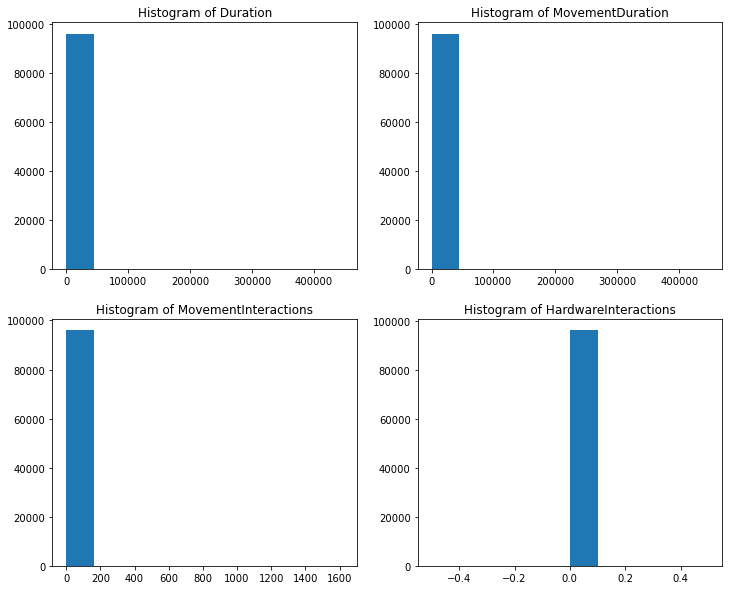

In [156]:
plt.figure(figsize=(12,10))
vars_to_plot = ['Duration', 'MovementDuration','MovementInteractions','HardwareInteractions']
for i, var in enumerate(vars_to_plot):
    plt.subplot(2,2,i+1)
    plt.hist(all_data[var])
    title_string = "Histogram of " + var
    plt.title(title_string)

In [182]:
dict_ollas = {pots.PotKey[i]: i for i in range(len(pots))}
all_data['id_olla'] = all_data.Key.map(dict_ollas)
all_data.head()

,Duration,MovementDuration,MovementInteractions,HardwareInteractions,Key,Date,Date_u,Time,id_olla
0,22,20,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:37:36.449000-05:00,2020-07-31,08:37:36.449000,0
1,15,0,0,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:39:34.086900-05:00,2020-07-31,08:39:34.086900,0
2,22,9,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:41:38.173900-05:00,2020-07-31,08:41:38.173900,0
3,15,0,1,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:53:33.820000-05:00,2020-07-31,08:53:33.820000,0
4,15,0,0,0,02a5d1c69f5d44cfa9d2a256e62725a7,2020-07-31 08:55:20.597000-05:00,2020-07-31,08:55:20.597000,0


In [177]:
range(len(pots))

range(0, 41)

In [185]:
fig = plotly.subplots.make_subplots(rows=4, cols=1)
vars_to_plot = ['Duration', 'MovementDuration','MovementInteractions','HardwareInteractions']

fig.append_trace(go.Box(x=all_data['id_olla'], y=all_data[vars_to_plot[0]]), row=1, col=1)
fig.append_trace(go.Box(x=all_data['id_olla'], y=all_data[vars_to_plot[1]]), row=2, col=1)
fig.append_trace(go.Box(x=all_data['id_olla'], y=all_data[vars_to_plot[2]]), row=3, col=1)
fig.append_trace(go.Box(x=all_data['id_olla'], y=all_data[vars_to_plot[3]]), row=4, col=1)

fig.show()

In [169]:
fig = px.box(all_data, x='Key', y=vars_to_plot[0],
             hover_data = ['Duration', 'MovementDuration','MovementInteractions','HardwareInteractions'])
fig.show()